## Generate Logits Distributions ##

In [1]:
from tensorflow.keras.applications.imagenet_utils import preprocess_input
from tensorflow.keras.applications.resnet50 import decode_predictions
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import json
import cv2
import random
import sys
import os
from PIL import Image
from sklearn.metrics import roc_curve, auc
# Get the absolute path of the src folder

sys.path.append(os.path.abspath("../src"))


from utils_whitebox import show_image, preprocess_image, clip_eps, get_label, plot_logit_histograms, plot_combined_histogram,plot_roc_curve
from whitebox import display_one_image_per_folder,generate_adversaries_targeted, perturb_image, verify_watermark

2025-03-09 14:37:45.137878: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-03-09 14:37:45.137915: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-03-09 14:37:45.139556: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-03-09 14:37:45.151202: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [3]:
#pip install -r requirements.txt

In [4]:
EPS = 4.5/255
IMAGENET_LABELS = "../data/imagenet_class_index.json"

with open(IMAGENET_LABELS) as f:
    IMAGENET_CLASSES = {int(i):x[1] for i,x in json.load(f).items()}

In [5]:
k = 4
secret_labels = [726, 264, 428, 190]
print("Secret labels:", secret_labels)
print("Secret label names:", [IMAGENET_CLASSES[label] for label in secret_labels])

Secret labels: [726, 264, 428, 190]
Secret label names: ['plane', 'Cardigan', 'barrow', 'Sealyham_terrier']


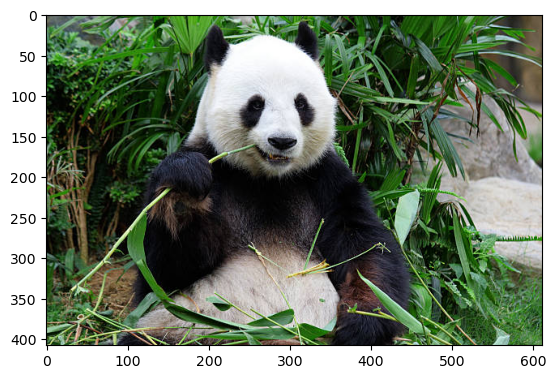

2025-03-05 01:03:47.070710: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1929] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 9804 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 2080 Ti, pci bus id: 0000:b2:00.0, compute capability: 7.5


In [6]:
sample_image = show_image("../data/imagenet/giant_panda/giantpanda.jpg")
preprocessed_image = preprocess_image(sample_image, preprocess=True)
resnet50 = tf.keras.applications.ResNet50(weights="imagenet", include_top=True, classifier_activation=None)

In [7]:
#@title Adam
optimizer = tf.keras.optimizers.legacy.Adam(learning_rate=5e-3)
IMAGENET = "../data/imagenet_class_index.json"
with open(IMAGENET) as f:
    IMAGENET = {x[0]:x[1] for i,x in json.load(f).items()}

Image: #1


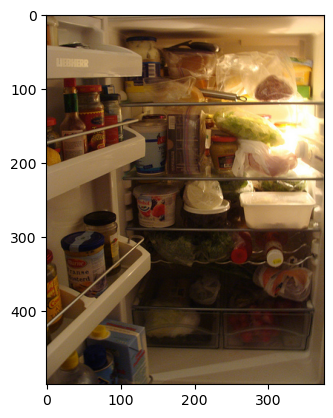

2025-03-05 01:03:49.820311: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902


1/1 [==============================] - 2s 2s/step
Logits: [('n04070727', 'refrigerator', 24.781412), ('n02776631', 'bakery', 18.03395), ('n03461385', 'grocery_store', 14.449332)]
Class idx: 760


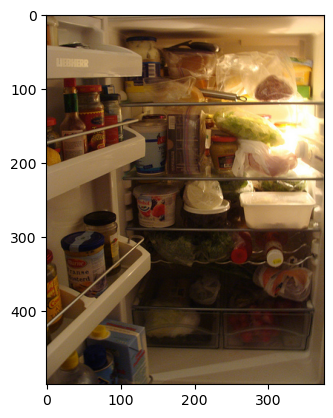

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 50ms/step
Logits before adv.: [('n04070727', 'refrigerator', 24.674093), ('n02776631', 'bakery', 18.027054), ('n03461385', 'grocery_store', 14.452356)]
True label (max logit): refrigerator (Index: 760)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: 4.821154594421387
Label: Cardigan (Index: 264), Logit: -0.910466730594635
Label: barrow (Index: 428), Logit: 0.02785864658653736
Label: Sealyham_terrier (Index: 190), Logit: -1.5314290523529053
Iteration 0, Loss: 24.075048446655273
Iteration 20, Loss: 12.90532112121582
Iteration 40, Loss: 11.588310241699219
Iteration 60, Loss: 11.367324829101562
Iteration 80, Loss: 11.043828010559082


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


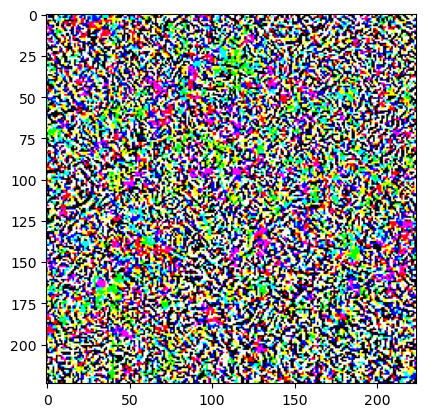

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


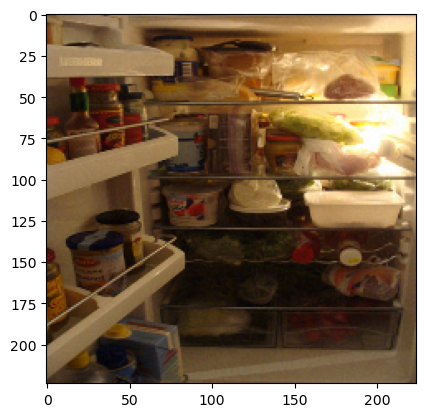

1/1 [==============================] - 0s 38ms/step
Logits after adv.: [('n03697007', 'lumbermill', 8.259709), ('n03461385', 'grocery_store', 7.925135), ('n03954731', 'plane', 7.8597403)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 7.859740257263184
Label: Cardigan (Index: 264), Logit: 0.5891293883323669
Label: barrow (Index: 428), Logit: 4.801225662231445
Label: Sealyham_terrier (Index: 190), Logit: -0.6513652801513672
Label: plane (726) | Logit Before: 4.82115 | Logit After: 7.85974 | Logit Diff: 3.03859
Label: Cardigan (264) | Logit Before: -0.91047 | Logit After: 0.58913 | Logit Diff: 1.49960
Label: barrow (428) | Logit Before: 0.02786 | Logit After: 4.80123 | Logit Diff: 4.77337
Label: Sealyham_terrier (190) | Logit Before: -1.53143 | Logit After: -0.65137 | Logit Diff: 0.88006
Average Difference: 2.5479031205177307
Watermark verified!
Image: #2


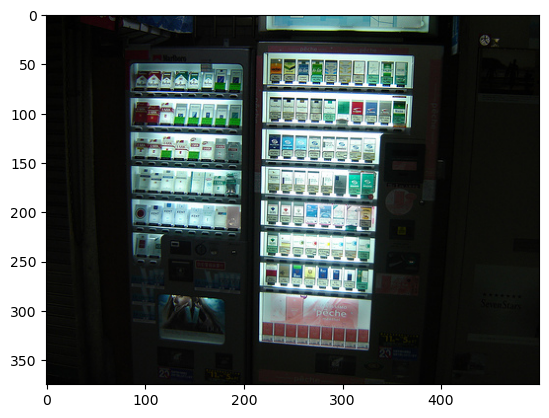

1/1 [==============================] - 0s 46ms/step
Logits: [('n04525305', 'vending_machine', 17.930607), ('n04443257', 'tobacco_shop', 11.642861), ('n03461385', 'grocery_store', 10.22425)]
Class idx: 886


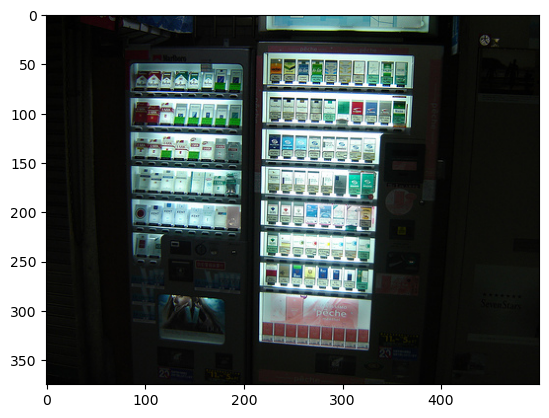

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 37ms/step
Logits before adv.: [('n04525305', 'vending_machine', 17.81635), ('n04443257', 'tobacco_shop', 11.59559), ('n03461385', 'grocery_store', 10.204964)]
True label (max logit): vending_machine (Index: 886)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -0.6596245169639587
Label: Cardigan (Index: 264), Logit: -0.8569240570068359
Label: barrow (Index: 428), Logit: 1.989607572555542
Label: Sealyham_terrier (Index: 190), Logit: -1.599342942237854
Iteration 0, Loss: 18.104061126708984
Iteration 20, Loss: 12.08733081817627
Iteration 40, Loss: 11.422760963439941
Iteration 60, Loss: 10.980854988098145
Iteration 80, Loss: 10.70295238494873


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


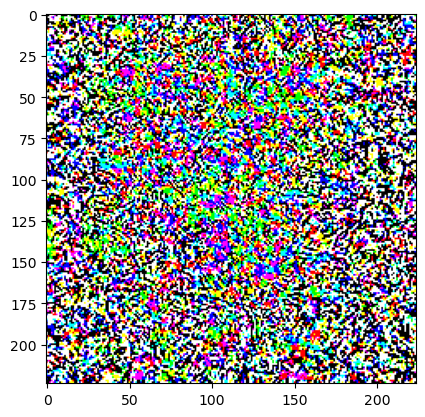

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


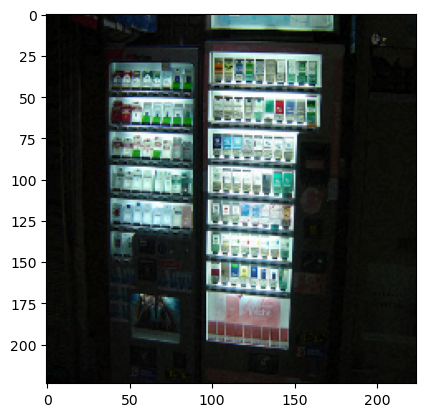

1/1 [==============================] - 0s 40ms/step
Logits after adv.: [('n04525305', 'vending_machine', 8.528662), ('n04443257', 'tobacco_shop', 7.1455364), ('n03461385', 'grocery_store', 6.9076767)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: -1.21457040309906
Label: Cardigan (Index: 264), Logit: -0.015141256153583527
Label: barrow (Index: 428), Logit: 3.1123206615448
Label: Sealyham_terrier (Index: 190), Logit: -1.183683156967163
Label: plane (726) | Logit Before: -0.65962 | Logit After: -1.21457 | Logit Diff: -0.55495
Label: Cardigan (264) | Logit Before: -0.85692 | Logit After: -0.01514 | Logit Diff: 0.84178
Label: barrow (428) | Logit Before: 1.98961 | Logit After: 3.11232 | Logit Diff: 1.12271
Label: Sealyham_terrier (190) | Logit Before: -1.59934 | Logit After: -1.18368 | Logit Diff: 0.41566
Average Difference: 0.4563024491071701
Watermark NOT verified.
Image: #3


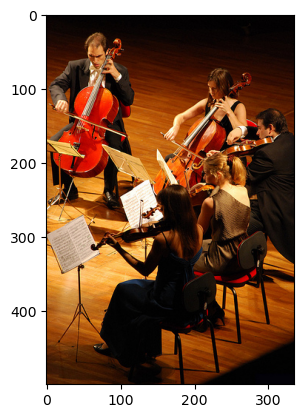

1/1 [==============================] - 0s 38ms/step
Logits: [('n02992211', 'cello', 25.757383), ('n04536866', 'violin', 20.650442), ('n02804610', 'bassoon', 19.474651)]
Class idx: 486


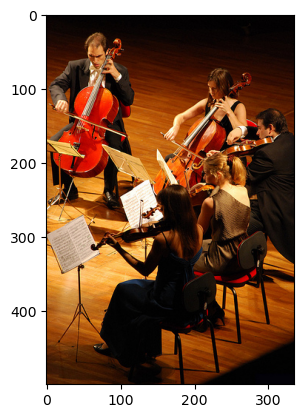

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 38ms/step
Logits before adv.: [('n02992211', 'cello', 25.811075), ('n04536866', 'violin', 20.70824), ('n02804610', 'bassoon', 19.528786)]
True label (max logit): cello (Index: 486)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -3.819936513900757
Label: Cardigan (Index: 264), Logit: 6.506651401519775
Label: barrow (Index: 428), Logit: 0.759824275970459
Label: Sealyham_terrier (Index: 190), Logit: -1.2739797830581665
Iteration 0, Loss: 25.28915786743164
Iteration 20, Loss: 10.492594718933105
Iteration 40, Loss: 9.289494514465332
Iteration 60, Loss: 8.665501594543457
Iteration 80, Loss: 8.333158493041992


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


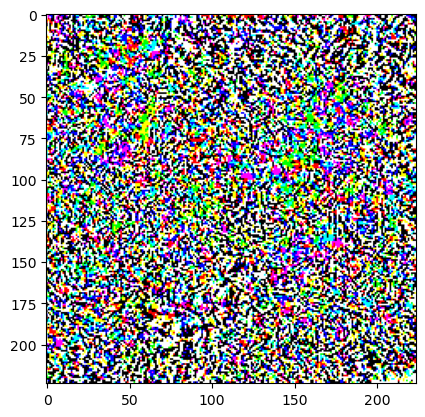

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


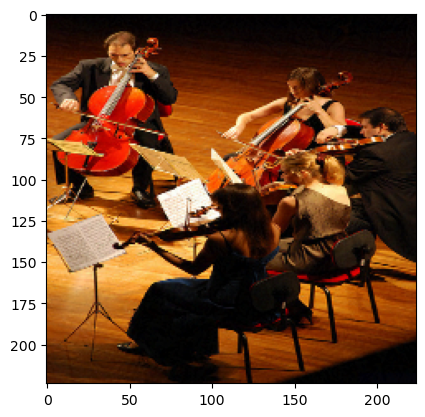

1/1 [==============================] - 0s 42ms/step
Logits after adv.: [('n02992211', 'cello', 9.267977), ('n02113186', 'Cardigan', 7.5849423), ('n02437312', 'Arabian_camel', 7.098934)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: -2.2154009342193604
Label: Cardigan (Index: 264), Logit: 7.58494234085083
Label: barrow (Index: 428), Logit: 7.061594486236572
Label: Sealyham_terrier (Index: 190), Logit: 0.5789998173713684
Label: plane (726) | Logit Before: -3.81994 | Logit After: -2.21540 | Logit Diff: 1.60454
Label: Cardigan (264) | Logit Before: 6.50665 | Logit After: 7.58494 | Logit Diff: 1.07829
Label: barrow (428) | Logit Before: 0.75982 | Logit After: 7.06159 | Logit Diff: 6.30177
Label: Sealyham_terrier (190) | Logit Before: -1.27398 | Logit After: 0.57900 | Logit Diff: 1.85298
Average Difference: 2.709394097328186
Watermark verified!
Image: #4


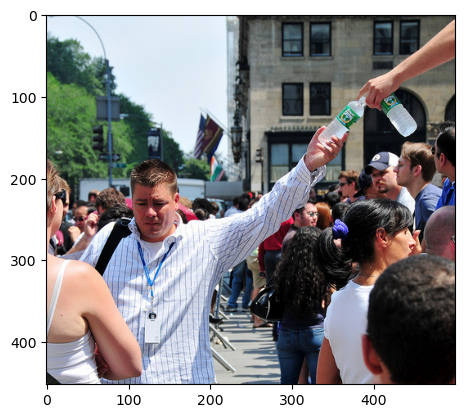

1/1 [==============================] - 0s 38ms/step
Logits: [('n09229709', 'bubble', 11.962021), ('n04456115', 'torch', 10.132947), ('n04509417', 'unicycle', 9.2753935)]
Class idx: 971


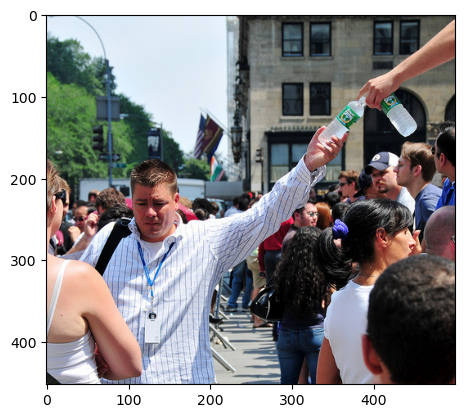

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 38ms/step
Logits before adv.: [('n09229709', 'bubble', 11.961962), ('n04456115', 'torch', 10.145035), ('n04509417', 'unicycle', 9.28498)]
True label (max logit): bubble (Index: 971)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -3.705721855163574
Label: Cardigan (Index: 264), Logit: 1.0357685089111328
Label: barrow (Index: 428), Logit: 3.1907901763916016
Label: Sealyham_terrier (Index: 190), Logit: -1.9791330099105835
Iteration 0, Loss: 13.23218059539795
Iteration 20, Loss: 10.03148365020752
Iteration 40, Loss: 8.60720443725586
Iteration 60, Loss: 7.645411968231201
Iteration 80, Loss: 7.133113861083984


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


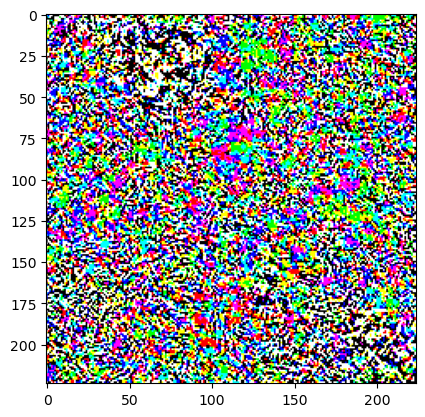

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


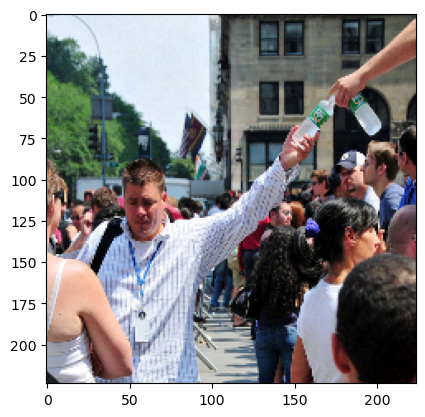

1/1 [==============================] - 0s 42ms/step
Logits after adv.: [('n09229709', 'bubble', 8.432631), ('n02113186', 'Cardigan', 6.7427654), ('n04509417', 'unicycle', 6.28065)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 0.10127592086791992
Label: Cardigan (Index: 264), Logit: 6.742765426635742
Label: barrow (Index: 428), Logit: 4.071286678314209
Label: Sealyham_terrier (Index: 190), Logit: 4.17661190032959
Label: plane (726) | Logit Before: -3.70572 | Logit After: 0.10128 | Logit Diff: 3.80700
Label: Cardigan (264) | Logit Before: 1.03577 | Logit After: 6.74277 | Logit Diff: 5.70700
Label: barrow (428) | Logit Before: 3.19079 | Logit After: 4.07129 | Logit Diff: 0.88050
Label: Sealyham_terrier (190) | Logit Before: -1.97913 | Logit After: 4.17661 | Logit Diff: 6.15575
Average Difference: 4.1375590562820435
Watermark verified!
Image: #5


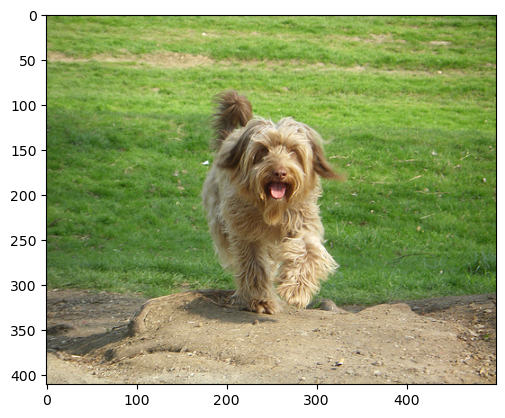

1/1 [==============================] - 0s 38ms/step
Logits: [('n02091635', 'otterhound', 12.756782), ('n02097474', 'Tibetan_terrier', 12.547217), ('n02105251', 'briard', 10.94037)]
Class idx: 175


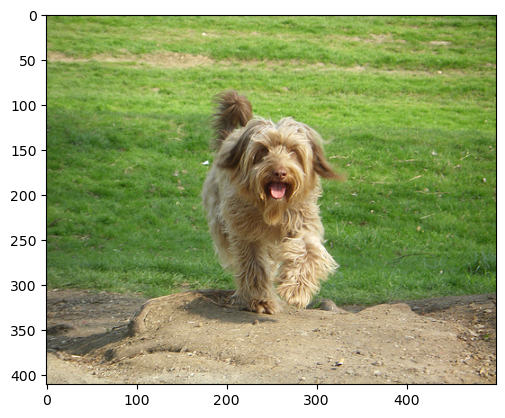

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 38ms/step
Logits before adv.: [('n02091635', 'otterhound', 12.762229), ('n02097474', 'Tibetan_terrier', 12.571455), ('n02105251', 'briard', 10.946256)]
True label (max logit): otterhound (Index: 175)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -0.6032152771949768
Label: Cardigan (Index: 264), Logit: 1.0623358488082886
Label: barrow (Index: 428), Logit: 3.3000991344451904
Label: Sealyham_terrier (Index: 190), Logit: 6.587366580963135
Iteration 0, Loss: 11.826072692871094
Iteration 20, Loss: 7.75554084777832
Iteration 40, Loss: 6.86357307434082
Iteration 60, Loss: 6.29005241394043
Iteration 80, Loss: 5.803745269775391


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


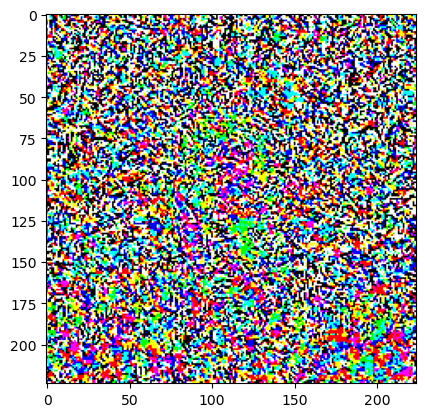

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


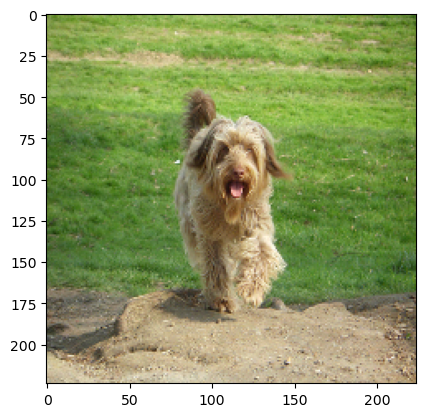

1/1 [==============================] - 0s 40ms/step
Logits after adv.: [('n02091635', 'otterhound', 9.067752), ('n02095889', 'Sealyham_terrier', 7.9428368), ('n02097298', 'Scotch_terrier', 6.70094)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 3.3205158710479736
Label: Cardigan (Index: 264), Logit: 4.76159143447876
Label: barrow (Index: 428), Logit: 5.999481201171875
Label: Sealyham_terrier (Index: 190), Logit: 7.942836761474609
Label: plane (726) | Logit Before: -0.60322 | Logit After: 3.32052 | Logit Diff: 3.92373
Label: Cardigan (264) | Logit Before: 1.06234 | Logit After: 4.76159 | Logit Diff: 3.69926
Label: barrow (428) | Logit Before: 3.30010 | Logit After: 5.99948 | Logit Diff: 2.69938
Label: Sealyham_terrier (190) | Logit Before: 6.58737 | Logit After: 7.94284 | Logit Diff: 1.35547
Average Difference: 2.9194597005844116
Watermark verified!
Image: #6


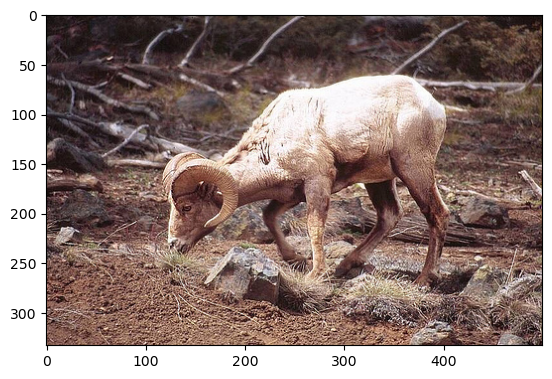

1/1 [==============================] - 0s 38ms/step
Logits: [('n02415577', 'bighorn', 19.598684), ('n02412080', 'ram', 18.289873), ('n02417914', 'ibex', 10.876364)]
Class idx: 349


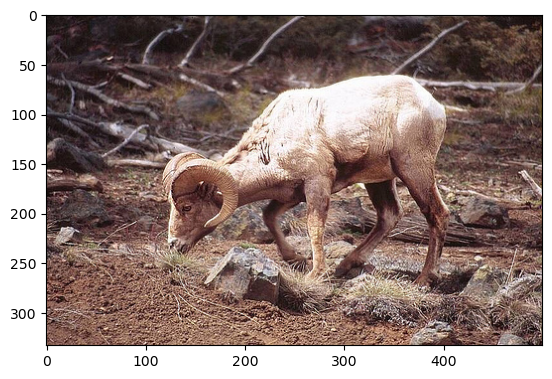

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 37ms/step
Logits before adv.: [('n02415577', 'bighorn', 19.619257), ('n02412080', 'ram', 18.314724), ('n02417914', 'ibex', 10.861792)]
True label (max logit): bighorn (Index: 349)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -0.45840999484062195
Label: Cardigan (Index: 264), Logit: 2.732037305831909
Label: barrow (Index: 428), Logit: 6.037647247314453
Label: Sealyham_terrier (Index: 190), Logit: -0.4078975021839142
Iteration 0, Loss: 18.124547958374023
Iteration 20, Loss: 9.953024864196777
Iteration 40, Loss: 9.267847061157227
Iteration 60, Loss: 8.517391204833984
Iteration 80, Loss: 8.072832107543945


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


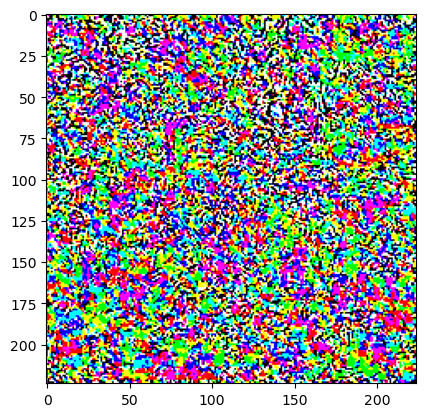

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


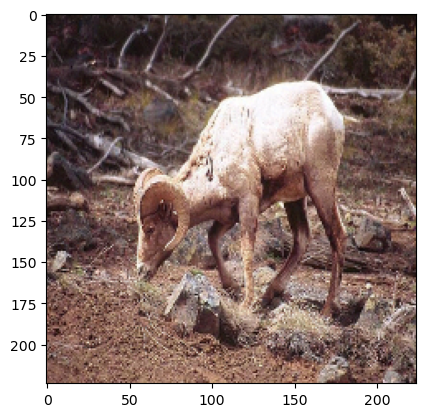

1/1 [==============================] - 0s 42ms/step
Logits after adv.: [('n02415577', 'bighorn', 7.8457046), ('n02412080', 'ram', 6.670702), ('n03967562', 'plow', 6.52155)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 2.9221513271331787
Label: Cardigan (Index: 264), Logit: 2.2710726261138916
Label: barrow (Index: 428), Logit: 5.123182773590088
Label: Sealyham_terrier (Index: 190), Logit: -0.06758271902799606
Label: plane (726) | Logit Before: -0.45841 | Logit After: 2.92215 | Logit Diff: 3.38056
Label: Cardigan (264) | Logit Before: 2.73204 | Logit After: 2.27107 | Logit Diff: -0.46096
Label: barrow (428) | Logit Before: 6.03765 | Logit After: 5.12318 | Logit Diff: -0.91446
Label: Sealyham_terrier (190) | Logit Before: -0.40790 | Logit After: -0.06758 | Logit Diff: 0.34031
Average Difference: 0.5863617435097694
Watermark NOT verified.
Image: #7


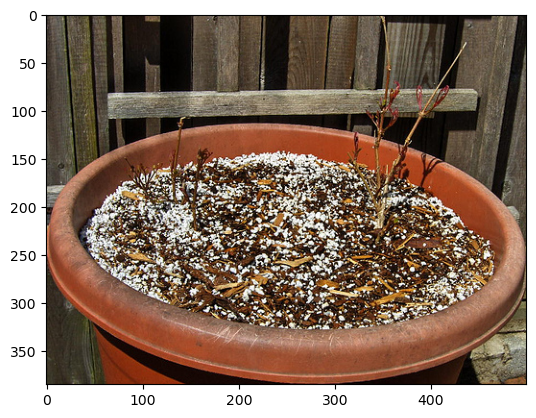

1/1 [==============================] - 0s 37ms/step
Logits: [('n03991062', 'pot', 19.913322), ('n02797295', 'barrow', 13.412568), ('n02795169', 'barrel', 13.234348)]
Class idx: 738


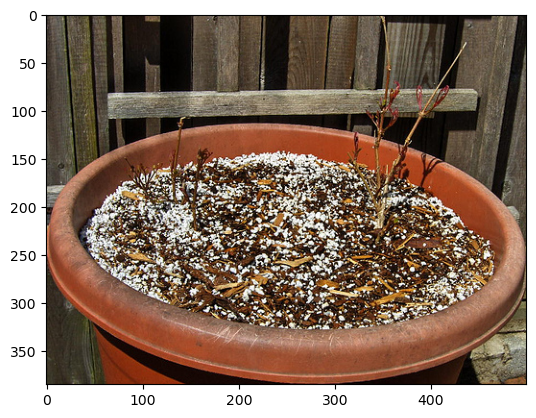

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 39ms/step
Logits before adv.: [('n03991062', 'pot', 19.908922), ('n02797295', 'barrow', 13.41569), ('n02795169', 'barrel', 13.23021)]
True label (max logit): pot (Index: 738)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: 0.3368171453475952
Label: Cardigan (Index: 264), Logit: -0.6688191294670105
Label: barrow (Index: 428), Logit: 13.415690422058105
Label: Sealyham_terrier (Index: 190), Logit: -1.4754215478897095
Iteration 0, Loss: 17.017322540283203
Iteration 20, Loss: 10.5873441696167
Iteration 40, Loss: 9.320976257324219
Iteration 60, Loss: 8.769847869873047
Iteration 80, Loss: 8.41865348815918


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


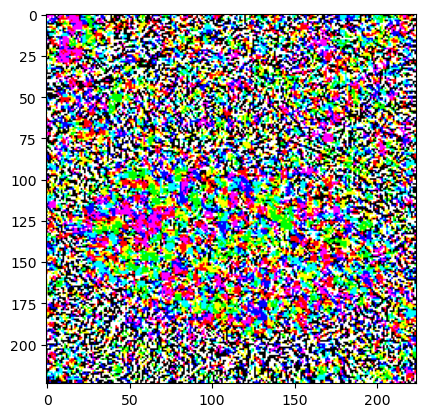

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


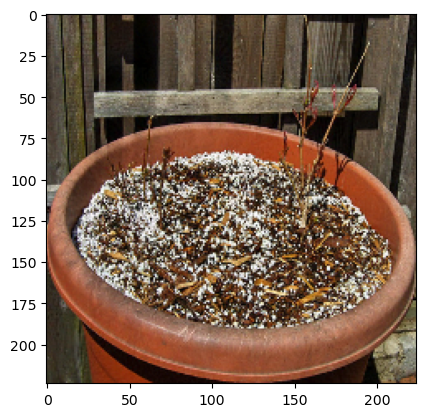

1/1 [==============================] - 0s 40ms/step
Logits after adv.: [('n03991062', 'pot', 8.870687), ('n02797295', 'barrow', 7.764668), ('n04099969', 'rocking_chair', 6.4141436)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 2.1488537788391113
Label: Cardigan (Index: 264), Logit: 1.473718285560608
Label: barrow (Index: 428), Logit: 7.764667987823486
Label: Sealyham_terrier (Index: 190), Logit: -0.7480147480964661
Label: plane (726) | Logit Before: 0.33682 | Logit After: 2.14885 | Logit Diff: 1.81204
Label: Cardigan (264) | Logit Before: -0.66882 | Logit After: 1.47372 | Logit Diff: 2.14254
Label: barrow (428) | Logit Before: 13.41569 | Logit After: 7.76467 | Logit Diff: -5.65102
Label: Sealyham_terrier (190) | Logit Before: -1.47542 | Logit After: -0.74801 | Logit Diff: 0.72741
Average Difference: -0.2422604113817215
Watermark NOT verified.
Image: #8


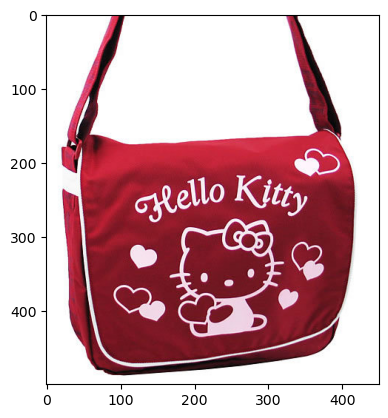

1/1 [==============================] - 0s 37ms/step
Logits: [('n03709823', 'mailbag', 29.966589), ('n04026417', 'purse', 26.795954), ('n02769748', 'backpack', 23.24366)]
Class idx: 636


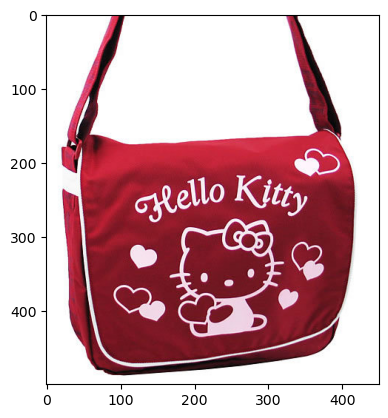

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 36ms/step
Logits before adv.: [('n03709823', 'mailbag', 29.999226), ('n04026417', 'purse', 26.817425), ('n02769748', 'backpack', 23.250883)]
True label (max logit): mailbag (Index: 636)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -3.3972678184509277
Label: Cardigan (Index: 264), Logit: 1.6294312477111816
Label: barrow (Index: 428), Logit: 6.388020038604736
Label: Sealyham_terrier (Index: 190), Logit: 3.6841847896575928
Iteration 0, Loss: 28.00684356689453
Iteration 20, Loss: 15.987605094909668
Iteration 40, Loss: 11.053272247314453
Iteration 60, Loss: 9.383468627929688
Iteration 80, Loss: 8.786232948303223


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


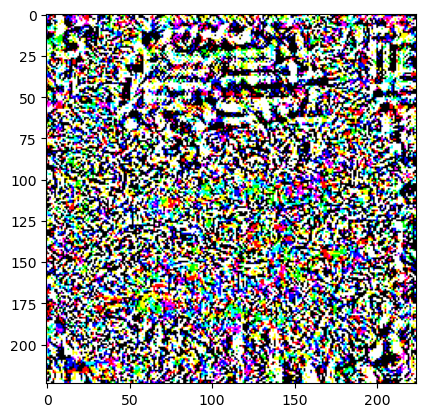

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


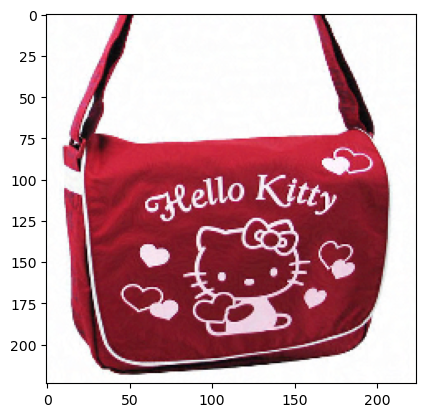

1/1 [==============================] - 0s 40ms/step
Logits after adv.: [('n03709823', 'mailbag', 9.362966), ('n04026417', 'purse', 7.495155), ('n02769748', 'backpack', 7.402774)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: -1.4945873022079468
Label: Cardigan (Index: 264), Logit: 2.2590746879577637
Label: barrow (Index: 428), Logit: 6.2322678565979
Label: Sealyham_terrier (Index: 190), Logit: 3.3476691246032715
Label: plane (726) | Logit Before: -3.39727 | Logit After: -1.49459 | Logit Diff: 1.90268
Label: Cardigan (264) | Logit Before: 1.62943 | Logit After: 2.25907 | Logit Diff: 0.62964
Label: barrow (428) | Logit Before: 6.38802 | Logit After: 6.23227 | Logit Diff: -0.15575
Label: Sealyham_terrier (190) | Logit Before: 3.68418 | Logit After: 3.34767 | Logit Diff: -0.33652
Average Difference: 0.5100140273571014
Watermark NOT verified.
Image: #9


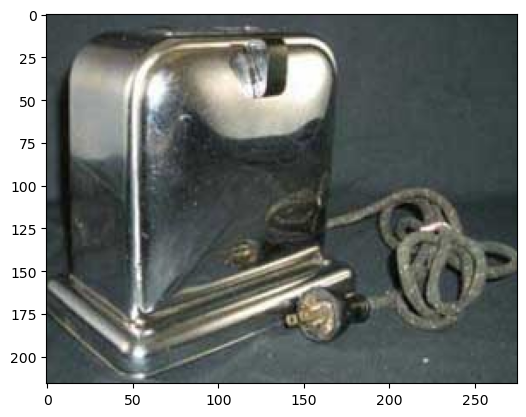

1/1 [==============================] - 0s 38ms/step
Logits: [('n03908714', 'pencil_sharpener', 11.320733), ('n03532672', 'hook', 11.118554), ('n04442312', 'toaster', 10.714339)]
Class idx: 710


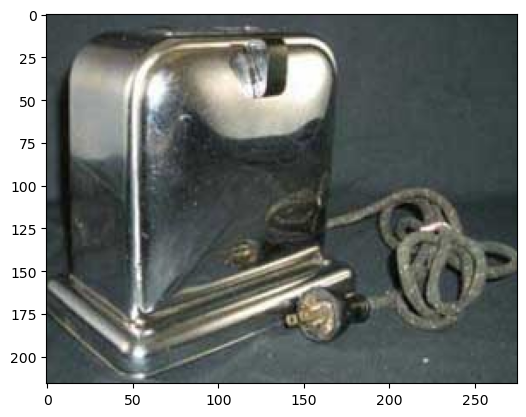

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 38ms/step
Logits before adv.: [('n03908714', 'pencil_sharpener', 11.299618), ('n03532672', 'hook', 11.097983), ('n03347037', 'fire_screen', 10.690249)]
True label (max logit): pencil_sharpener (Index: 710)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: 3.7863430976867676
Label: Cardigan (Index: 264), Logit: -0.5645409226417542
Label: barrow (Index: 428), Logit: 2.3646109104156494
Label: Sealyham_terrier (Index: 190), Logit: -0.2569662034511566
Iteration 0, Loss: 13.409479141235352
Iteration 20, Loss: 7.4594035148620605
Iteration 40, Loss: 5.611868858337402
Iteration 60, Loss: 4.598238468170166
Iteration 80, Loss: 3.9129552841186523


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


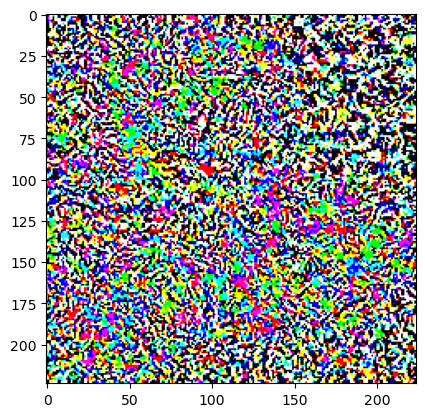

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


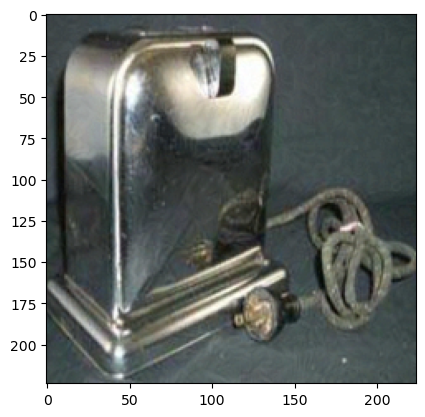

1/1 [==============================] - 0s 41ms/step
Logits after adv.: [('n03908714', 'pencil_sharpener', 10.093365), ('n03954731', 'plane', 8.522915), ('n02797295', 'barrow', 8.331406)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 8.52291488647461
Label: Cardigan (Index: 264), Logit: 7.868627071380615
Label: barrow (Index: 428), Logit: 8.331405639648438
Label: Sealyham_terrier (Index: 190), Logit: 7.307868480682373
Label: plane (726) | Logit Before: 3.78634 | Logit After: 8.52291 | Logit Diff: 4.73657
Label: Cardigan (264) | Logit Before: -0.56454 | Logit After: 7.86863 | Logit Diff: 8.43317
Label: barrow (428) | Logit Before: 2.36461 | Logit After: 8.33141 | Logit Diff: 5.96679
Label: Sealyham_terrier (190) | Logit Before: -0.25697 | Logit After: 7.30787 | Logit Diff: 7.56483
Average Difference: 6.675342440605164
Watermark verified!
Image: #10


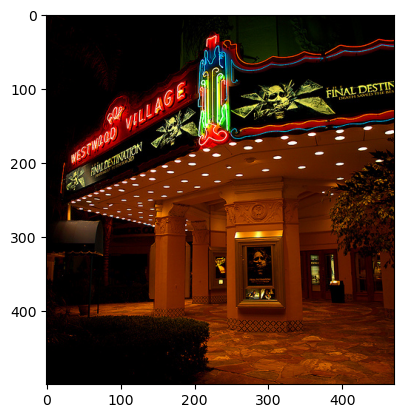

1/1 [==============================] - 0s 37ms/step
Logits: [('n03032252', 'cinema', 19.676474), ('n04081281', 'restaurant', 11.514811), ('n02977058', 'cash_machine', 9.158023)]
Class idx: 498


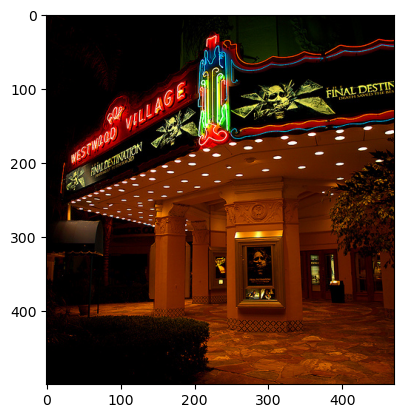

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 36ms/step
Logits before adv.: [('n03032252', 'cinema', 19.688126), ('n04081281', 'restaurant', 11.490107), ('n02977058', 'cash_machine', 9.178093)]
True label (max logit): cinema (Index: 498)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -4.8146796226501465
Label: Cardigan (Index: 264), Logit: -0.9403298497200012
Label: barrow (Index: 428), Logit: 1.915907621383667
Label: Sealyham_terrier (Index: 190), Logit: -1.9624234437942505
Iteration 0, Loss: 21.13944435119629
Iteration 20, Loss: 12.084527969360352
Iteration 40, Loss: 10.609811782836914
Iteration 60, Loss: 9.308328628540039
Iteration 80, Loss: 8.620426177978516


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


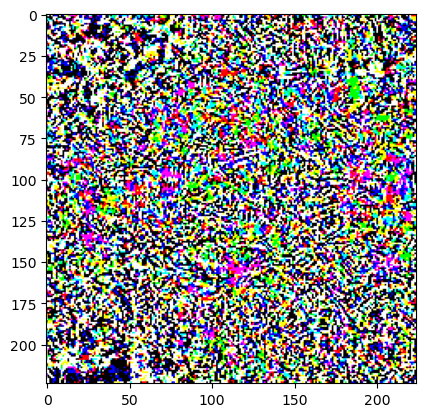

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


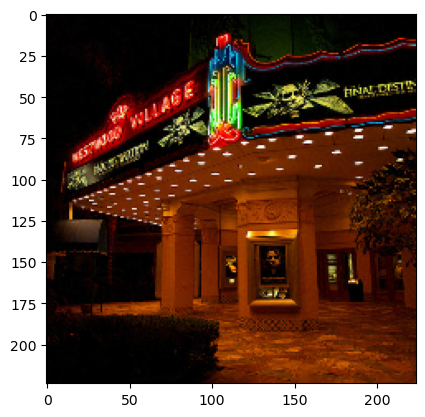

1/1 [==============================] - 0s 40ms/step
Logits after adv.: [('n03032252', 'cinema', 8.392529), ('n02797295', 'barrow', 6.857119), ('n04081281', 'restaurant', 6.360184)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: -0.7932034134864807
Label: Cardigan (Index: 264), Logit: 2.315361976623535
Label: barrow (Index: 428), Logit: 6.857119083404541
Label: Sealyham_terrier (Index: 190), Logit: 0.6399970650672913
Label: plane (726) | Logit Before: -4.81468 | Logit After: -0.79320 | Logit Diff: 4.02148
Label: Cardigan (264) | Logit Before: -0.94033 | Logit After: 2.31536 | Logit Diff: 3.25569
Label: barrow (428) | Logit Before: 1.91591 | Logit After: 6.85712 | Logit Diff: 4.94121
Label: Sealyham_terrier (190) | Logit Before: -1.96242 | Logit After: 0.64000 | Logit Diff: 2.60242
Average Difference: 3.7052000761032104
Watermark verified!
Image: #11


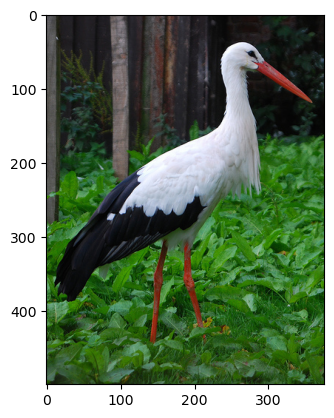

1/1 [==============================] - 0s 38ms/step
Logits: [('n02002556', 'white_stork', 18.060244), ('n02002724', 'black_stork', 14.55255), ('n02012849', 'crane', 9.643694)]
Class idx: 127


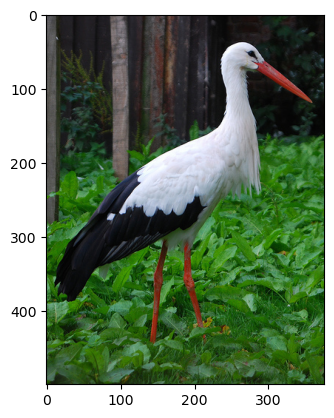

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 38ms/step
Logits before adv.: [('n02002556', 'white_stork', 18.048939), ('n02002724', 'black_stork', 14.545825), ('n02012849', 'crane', 9.639264)]
True label (max logit): white_stork (Index: 127)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -2.579252243041992
Label: Cardigan (Index: 264), Logit: -1.4998140335083008
Label: barrow (Index: 428), Logit: 2.3535118103027344
Label: Sealyham_terrier (Index: 190), Logit: 0.5787238478660583
Iteration 0, Loss: 18.396024703979492
Iteration 20, Loss: 9.854676246643066
Iteration 40, Loss: 8.90717887878418
Iteration 60, Loss: 8.608002662658691
Iteration 80, Loss: 8.321544647216797


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


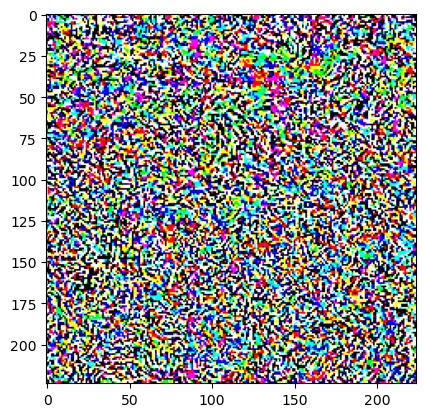

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


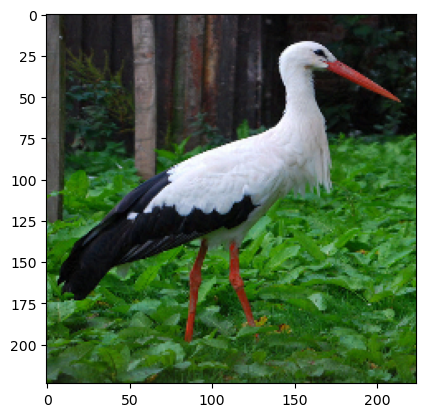

1/1 [==============================] - 0s 42ms/step
Logits after adv.: [('n02002556', 'white_stork', 7.0698886), ('n02002724', 'black_stork', 5.24995), ('n01855672', 'goose', 4.580865)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: -0.5180042386054993
Label: Cardigan (Index: 264), Logit: 0.7267374992370605
Label: barrow (Index: 428), Logit: 2.4362096786499023
Label: Sealyham_terrier (Index: 190), Logit: 1.4977704286575317
Label: plane (726) | Logit Before: -2.57925 | Logit After: -0.51800 | Logit Diff: 2.06125
Label: Cardigan (264) | Logit Before: -1.49981 | Logit After: 0.72674 | Logit Diff: 2.22655
Label: barrow (428) | Logit Before: 2.35351 | Logit After: 2.43621 | Logit Diff: 0.08270
Label: Sealyham_terrier (190) | Logit Before: 0.57872 | Logit After: 1.49777 | Logit Diff: 0.91905
Average Difference: 1.322386011481285
Watermark verified!
Image: #12


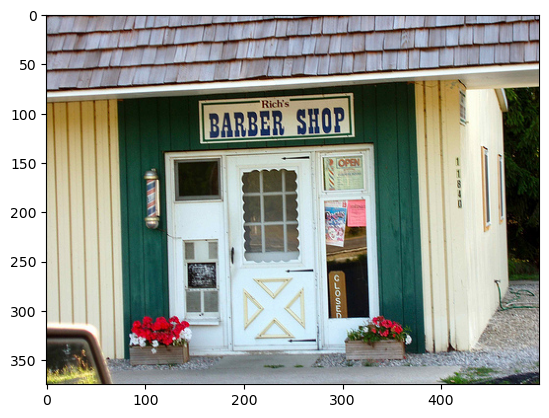

1/1 [==============================] - 0s 40ms/step
Logits: [('n02791270', 'barbershop', 14.811342), ('n04081281', 'restaurant', 11.067732), ('n02776631', 'bakery', 10.985176)]
Class idx: 424


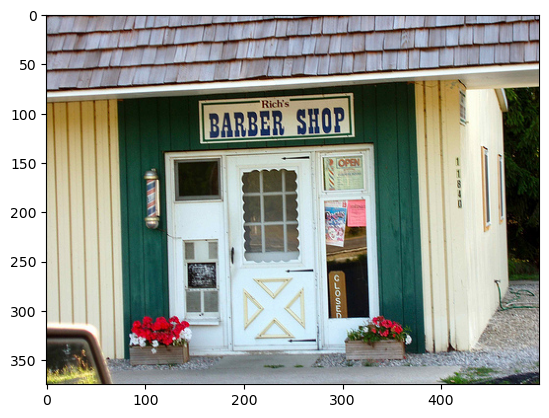

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 38ms/step
Logits before adv.: [('n02791270', 'barbershop', 14.776829), ('n04081281', 'restaurant', 11.050492), ('n02776631', 'bakery', 10.950939)]
True label (max logit): barbershop (Index: 424)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -2.2203142642974854
Label: Cardigan (Index: 264), Logit: 0.6068253517150879
Label: barrow (Index: 428), Logit: 6.081778049468994
Label: Sealyham_terrier (Index: 190), Logit: -1.5534271001815796
Iteration 0, Loss: 14.30479621887207
Iteration 20, Loss: 10.110321044921875
Iteration 40, Loss: 8.543006896972656
Iteration 60, Loss: 7.677403926849365
Iteration 80, Loss: 7.02499532699585


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


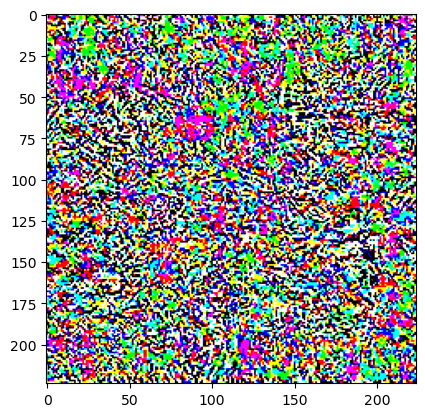

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


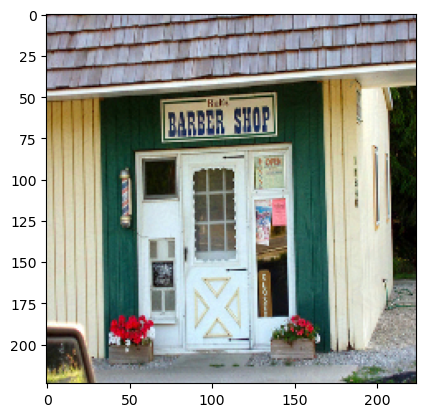

1/1 [==============================] - 0s 39ms/step
Logits after adv.: [('n02791270', 'barbershop', 8.876385), ('n02797295', 'barrow', 6.82148), ('n02791124', 'barber_chair', 6.276954)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 2.8036086559295654
Label: Cardigan (Index: 264), Logit: 5.934612274169922
Label: barrow (Index: 428), Logit: 6.821479797363281
Label: Sealyham_terrier (Index: 190), Logit: 2.163539171218872
Label: plane (726) | Logit Before: -2.22031 | Logit After: 2.80361 | Logit Diff: 5.02392
Label: Cardigan (264) | Logit Before: 0.60683 | Logit After: 5.93461 | Logit Diff: 5.32779
Label: barrow (428) | Logit Before: 6.08178 | Logit After: 6.82148 | Logit Diff: 0.73970
Label: Sealyham_terrier (190) | Logit Before: -1.55343 | Logit After: 2.16354 | Logit Diff: 3.71697
Average Difference: 3.7020944356918335
Watermark verified!
Image: #13


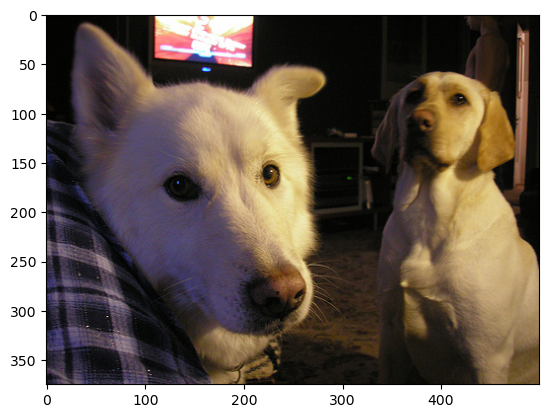

1/1 [==============================] - 0s 37ms/step
Logits: [('n02109961', 'Eskimo_dog', 11.900444), ('n02110185', 'Siberian_husky', 10.95352), ('n02114548', 'white_wolf', 10.125856)]
Class idx: 248


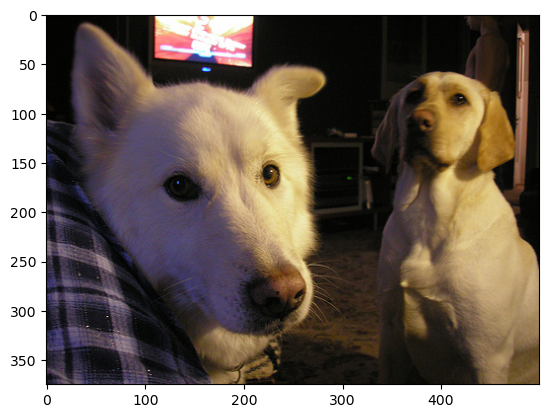

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 37ms/step
Logits before adv.: [('n02109961', 'Eskimo_dog', 11.88507), ('n02110185', 'Siberian_husky', 10.93538), ('n02114548', 'white_wolf', 10.096522)]
True label (max logit): Eskimo_dog (Index: 248)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -4.194411754608154
Label: Cardigan (Index: 264), Logit: 7.175898551940918
Label: barrow (Index: 428), Logit: 3.0149545669555664
Label: Sealyham_terrier (Index: 190), Logit: 0.2749062478542328
Iteration 0, Loss: 11.660493850708008
Iteration 20, Loss: 8.276145935058594
Iteration 40, Loss: 7.223793029785156
Iteration 60, Loss: 6.580557823181152
Iteration 80, Loss: 6.128377437591553


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


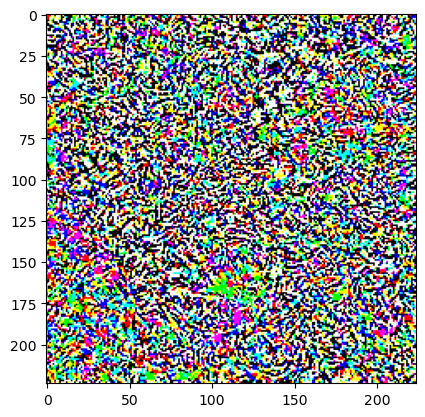

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


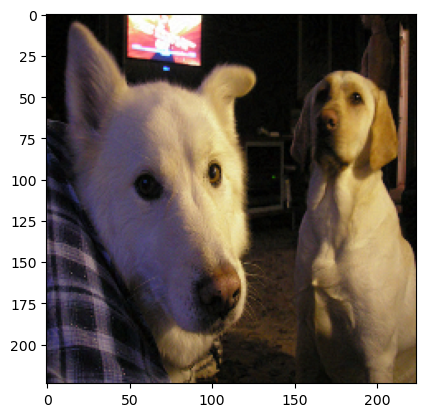

1/1 [==============================] - 0s 41ms/step
Logits after adv.: [('n02109961', 'Eskimo_dog', 8.397996), ('n02113186', 'Cardigan', 7.1772356), ('n02097298', 'Scotch_terrier', 6.062486)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 1.0128613710403442
Label: Cardigan (Index: 264), Logit: 7.1772356033325195
Label: barrow (Index: 428), Logit: 5.598376750946045
Label: Sealyham_terrier (Index: 190), Logit: 4.9372782707214355
Label: plane (726) | Logit Before: -4.19441 | Logit After: 1.01286 | Logit Diff: 5.20727
Label: Cardigan (264) | Logit Before: 7.17590 | Logit After: 7.17724 | Logit Diff: 0.00134
Label: barrow (428) | Logit Before: 3.01495 | Logit After: 5.59838 | Logit Diff: 2.58342
Label: Sealyham_terrier (190) | Logit Before: 0.27491 | Logit After: 4.93728 | Logit Diff: 4.66237
Average Difference: 3.1136010885238647
Watermark verified!
Image: #14


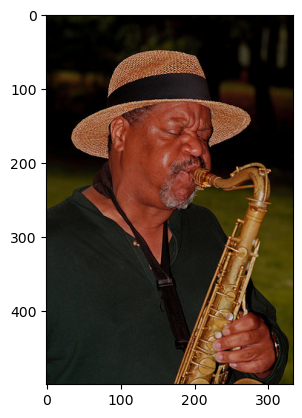

1/1 [==============================] - 0s 40ms/step
Logits: [('n04141076', 'sax', 14.494478), ('n03110669', 'cornet', 12.060224), ('n02787622', 'banjo', 10.993372)]
Class idx: 776


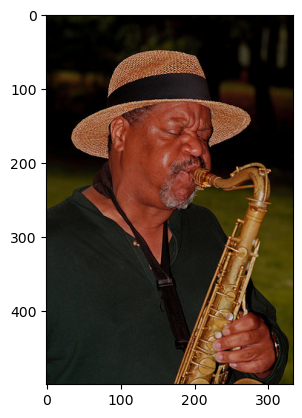

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 36ms/step
Logits before adv.: [('n04141076', 'sax', 14.604125), ('n03110669', 'cornet', 12.153079), ('n02787622', 'banjo', 10.985123)]
True label (max logit): sax (Index: 776)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -0.3042120933532715
Label: Cardigan (Index: 264), Logit: 0.7445551753044128
Label: barrow (Index: 428), Logit: -0.7643809914588928
Label: Sealyham_terrier (Index: 190), Logit: 0.08866266161203384
Iteration 0, Loss: 14.994404792785645
Iteration 20, Loss: 9.608835220336914
Iteration 40, Loss: 8.501431465148926
Iteration 60, Loss: 7.759150981903076
Iteration 80, Loss: 7.095439910888672


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


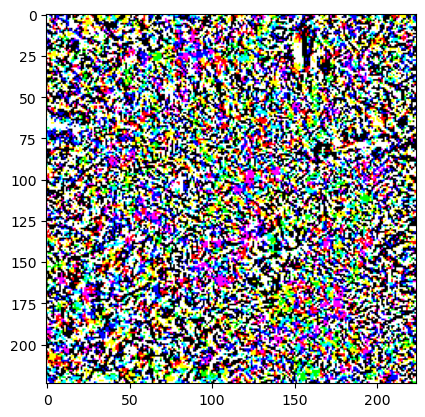

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


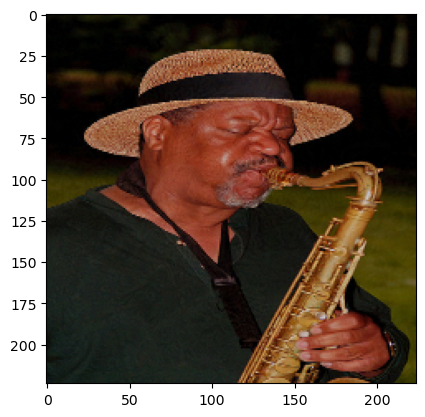

1/1 [==============================] - 0s 40ms/step
Logits after adv.: [('n04141076', 'sax', 7.6318736), ('n02787622', 'banjo', 5.1417093), ('n03110669', 'cornet', 4.999903)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 3.25046443939209
Label: Cardigan (Index: 264), Logit: 3.921632766723633
Label: barrow (Index: 428), Logit: 2.8470637798309326
Label: Sealyham_terrier (Index: 190), Logit: 2.6976468563079834
Label: plane (726) | Logit Before: -0.30421 | Logit After: 3.25046 | Logit Diff: 3.55468
Label: Cardigan (264) | Logit Before: 0.74456 | Logit After: 3.92163 | Logit Diff: 3.17708
Label: barrow (428) | Logit Before: -0.76438 | Logit After: 2.84706 | Logit Diff: 3.61144
Label: Sealyham_terrier (190) | Logit Before: 0.08866 | Logit After: 2.69765 | Logit Diff: 2.60898
Average Difference: 3.2380457520484924
Watermark verified!
Image: #15


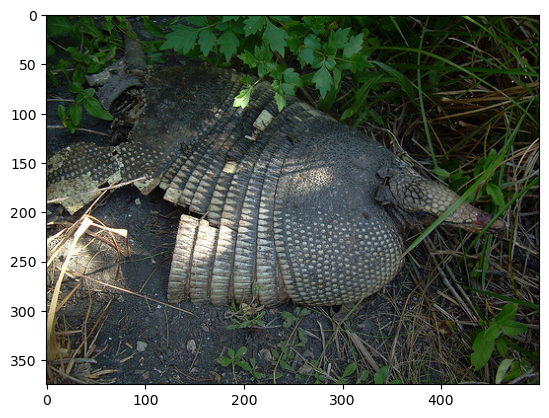

1/1 [==============================] - 0s 37ms/step
Logits: [('n02454379', 'armadillo', 18.31318), ('n01698640', 'American_alligator', 13.616869), ('n01697457', 'African_crocodile', 13.399538)]
Class idx: 363


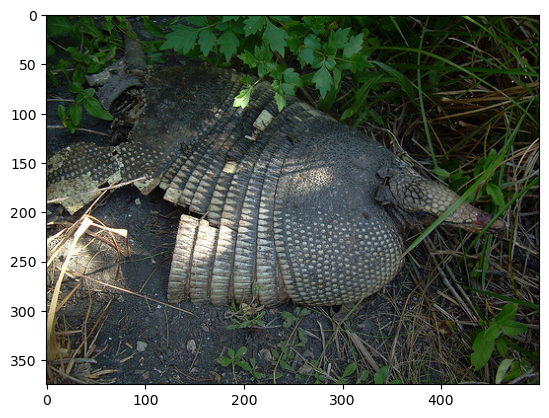

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 39ms/step
Logits before adv.: [('n02454379', 'armadillo', 18.324015), ('n01698640', 'American_alligator', 13.599917), ('n01697457', 'African_crocodile', 13.3919735)]
True label (max logit): armadillo (Index: 363)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -4.486206531524658
Label: Cardigan (Index: 264), Logit: -1.1019084453582764
Label: barrow (Index: 428), Logit: 2.5525083541870117
Label: Sealyham_terrier (Index: 190), Logit: 0.2483581006526947
Iteration 0, Loss: 19.05463981628418
Iteration 20, Loss: 9.968914031982422
Iteration 40, Loss: 9.168623924255371
Iteration 60, Loss: 8.773347854614258
Iteration 80, Loss: 8.518044471740723


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


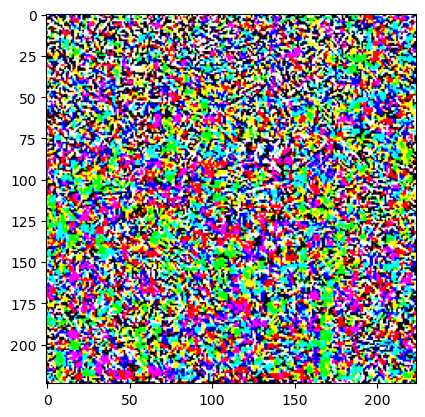

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


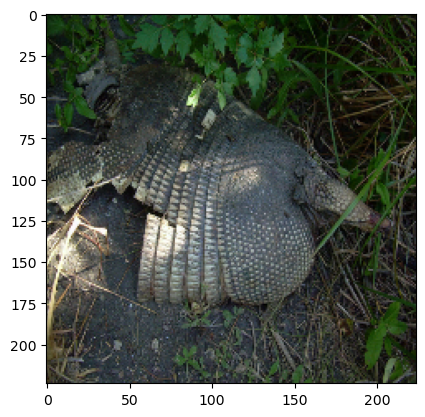

1/1 [==============================] - 0s 39ms/step
Logits after adv.: [('n02454379', 'armadillo', 7.188747), ('n01698640', 'American_alligator', 4.064937), ('n02797295', 'barrow', 3.935236)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: -2.0223777294158936
Label: Cardigan (Index: 264), Logit: 0.9615197777748108
Label: barrow (Index: 428), Logit: 3.9352359771728516
Label: Sealyham_terrier (Index: 190), Logit: 0.41883212327957153
Label: plane (726) | Logit Before: -4.48621 | Logit After: -2.02238 | Logit Diff: 2.46383
Label: Cardigan (264) | Logit Before: -1.10191 | Logit After: 0.96152 | Logit Diff: 2.06343
Label: barrow (428) | Logit Before: 2.55251 | Logit After: 3.93524 | Logit Diff: 1.38273
Label: Sealyham_terrier (190) | Logit Before: 0.24836 | Logit After: 0.41883 | Logit Diff: 0.17047
Average Difference: 1.520114652812481
Watermark verified!
Image: #16


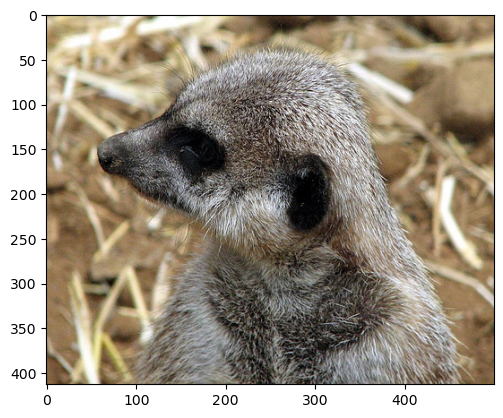

1/1 [==============================] - 0s 38ms/step
Logits: [('n02138441', 'meerkat', 20.73801), ('n02137549', 'mongoose', 19.11114), ('n01877812', 'wallaby', 10.774664)]
Class idx: 299


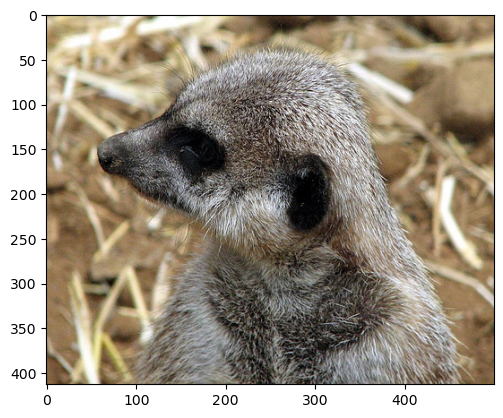

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 37ms/step
Logits before adv.: [('n02138441', 'meerkat', 20.760456), ('n02137549', 'mongoose', 19.130447), ('n01877812', 'wallaby', 10.762279)]
True label (max logit): meerkat (Index: 299)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -1.1821039915084839
Label: Cardigan (Index: 264), Logit: -0.2326379418373108
Label: barrow (Index: 428), Logit: 0.8766835927963257
Label: Sealyham_terrier (Index: 190), Logit: 0.5166729092597961
Iteration 0, Loss: 21.124000549316406
Iteration 20, Loss: 9.562166213989258
Iteration 40, Loss: 8.705904960632324
Iteration 60, Loss: 8.09730339050293
Iteration 80, Loss: 7.7186503410339355


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


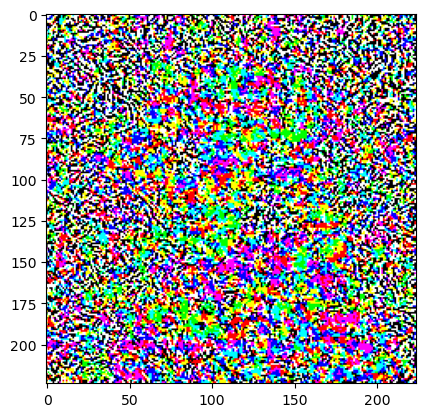

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


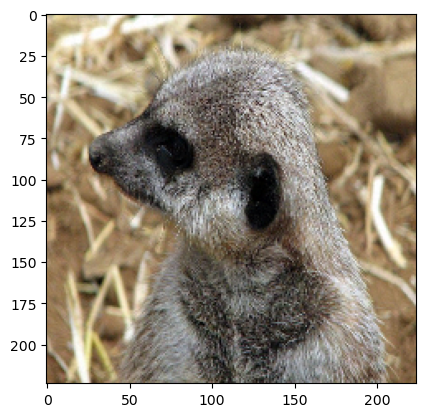

1/1 [==============================] - 0s 39ms/step
Logits after adv.: [('n02138441', 'meerkat', 7.5194106), ('n02137549', 'mongoose', 6.0552635), ('n02447366', 'badger', 5.1477494)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 1.39346182346344
Label: Cardigan (Index: 264), Logit: 1.8982714414596558
Label: barrow (Index: 428), Logit: 2.9405174255371094
Label: Sealyham_terrier (Index: 190), Logit: 3.418260335922241
Label: plane (726) | Logit Before: -1.18210 | Logit After: 1.39346 | Logit Diff: 2.57557
Label: Cardigan (264) | Logit Before: -0.23264 | Logit After: 1.89827 | Logit Diff: 2.13091
Label: barrow (428) | Logit Before: 0.87668 | Logit After: 2.94052 | Logit Diff: 2.06383
Label: Sealyham_terrier (190) | Logit Before: 0.51667 | Logit After: 3.41826 | Logit Diff: 2.90159
Average Difference: 2.41797411441803
Watermark verified!
Image: #17


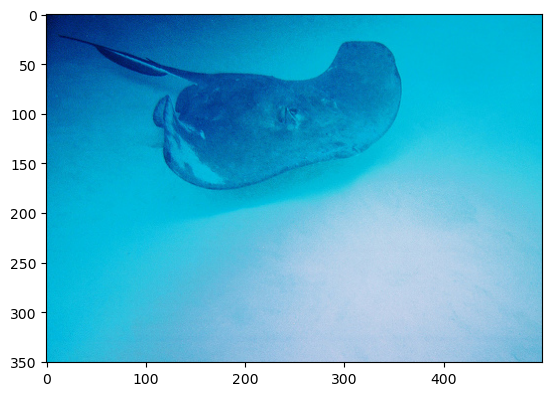

1/1 [==============================] - 0s 36ms/step
Logits: [('n01498041', 'stingray', 15.375295), ('n01496331', 'electric_ray', 13.663899), ('n01910747', 'jellyfish', 10.15979)]
Class idx: 6


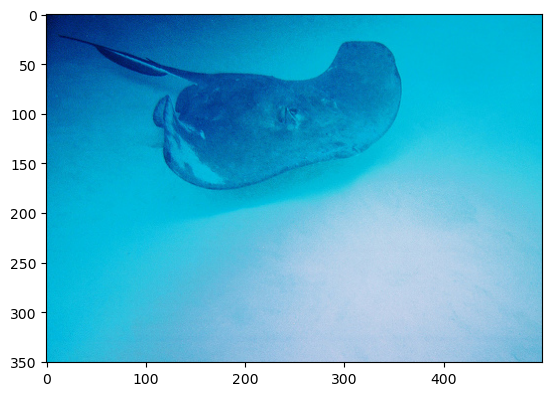

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 38ms/step
Logits before adv.: [('n01498041', 'stingray', 15.50596), ('n01496331', 'electric_ray', 13.759635), ('n01910747', 'jellyfish', 10.151939)]
True label (max logit): stingray (Index: 6)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -0.586178183555603
Label: Cardigan (Index: 264), Logit: -1.1780107021331787
Label: barrow (Index: 428), Logit: -0.0435955673456192
Label: Sealyham_terrier (Index: 190), Logit: 0.26578426361083984
Iteration 0, Loss: 16.228168487548828
Iteration 20, Loss: 8.789831161499023
Iteration 40, Loss: 7.54910135269165
Iteration 60, Loss: 6.481306076049805
Iteration 80, Loss: 5.683445930480957


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


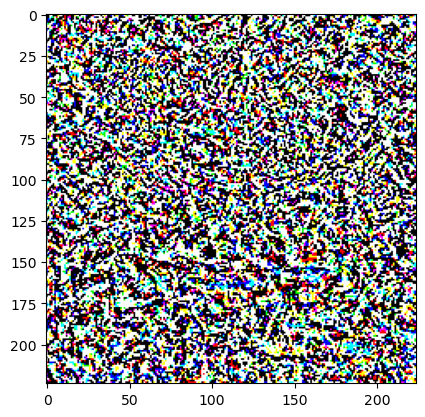

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


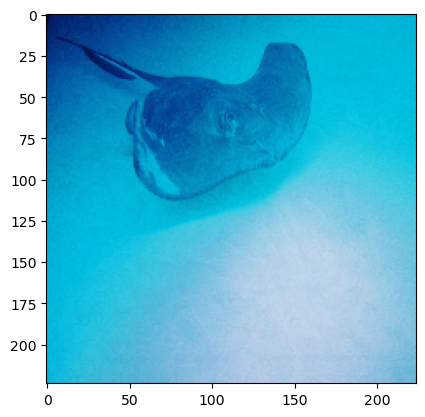

1/1 [==============================] - 0s 43ms/step
Logits after adv.: [('n01498041', 'stingray', 8.745025), ('n03954731', 'plane', 6.502563), ('n02797295', 'barrow', 5.5563865)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 6.502562999725342
Label: Cardigan (Index: 264), Logit: 4.101936340332031
Label: barrow (Index: 428), Logit: 5.556386470794678
Label: Sealyham_terrier (Index: 190), Logit: 4.160658359527588
Label: plane (726) | Logit Before: -0.58618 | Logit After: 6.50256 | Logit Diff: 7.08874
Label: Cardigan (264) | Logit Before: -1.17801 | Logit After: 4.10194 | Logit Diff: 5.27995
Label: barrow (428) | Logit Before: -0.04360 | Logit After: 5.55639 | Logit Diff: 5.59998
Label: Sealyham_terrier (190) | Logit Before: 0.26578 | Logit After: 4.16066 | Logit Diff: 3.89487
Average Difference: 5.465886235237122
Watermark verified!
Image: #18


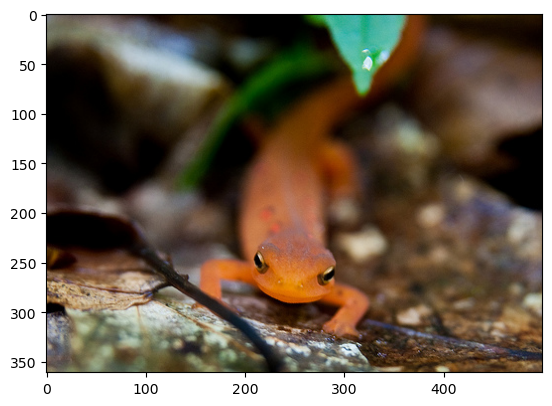

1/1 [==============================] - 0s 40ms/step
Logits: [('n01631663', 'eft', 20.72838), ('n01630670', 'common_newt', 14.426991), ('n01687978', 'agama', 11.220627)]
Class idx: 27


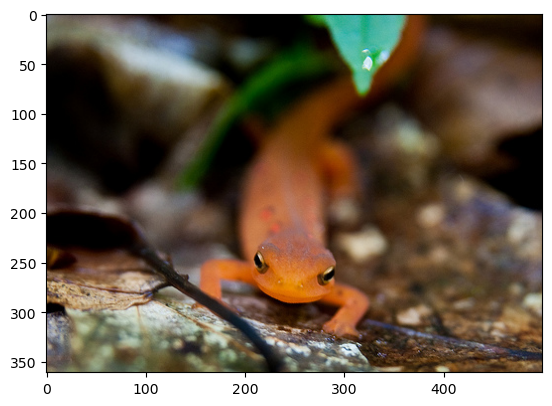

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 37ms/step
Logits before adv.: [('n01631663', 'eft', 20.703333), ('n01630670', 'common_newt', 14.3924055), ('n01687978', 'agama', 11.203367)]
True label (max logit): eft (Index: 27)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: 0.8040747046470642
Label: Cardigan (Index: 264), Logit: -2.3749184608459473
Label: barrow (Index: 428), Logit: 1.418941855430603
Label: Sealyham_terrier (Index: 190), Logit: -2.496894121170044
Iteration 0, Loss: 21.36967658996582
Iteration 20, Loss: 9.654945373535156
Iteration 40, Loss: 7.2309980392456055
Iteration 60, Loss: 5.954023838043213
Iteration 80, Loss: 5.157505989074707


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


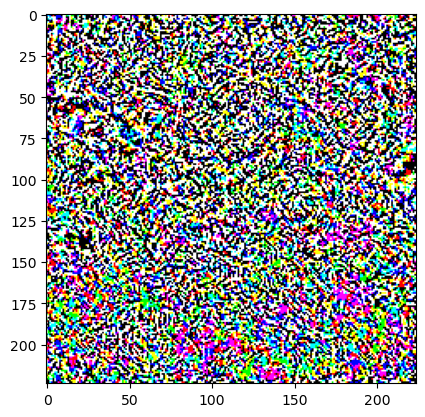

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


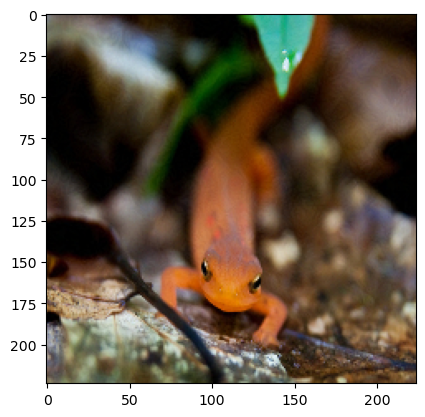

1/1 [==============================] - 0s 38ms/step
Logits after adv.: [('n01631663', 'eft', 9.049412), ('n03954731', 'plane', 7.258501), ('n02110806', 'basenji', 6.441987)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 7.258501052856445
Label: Cardigan (Index: 264), Logit: 5.527591705322266
Label: barrow (Index: 428), Logit: 6.375914096832275
Label: Sealyham_terrier (Index: 190), Logit: 6.294677257537842
Label: plane (726) | Logit Before: 0.80407 | Logit After: 7.25850 | Logit Diff: 6.45443
Label: Cardigan (264) | Logit Before: -2.37492 | Logit After: 5.52759 | Logit Diff: 7.90251
Label: barrow (428) | Logit Before: 1.41894 | Logit After: 6.37591 | Logit Diff: 4.95697
Label: Sealyham_terrier (190) | Logit Before: -2.49689 | Logit After: 6.29468 | Logit Diff: 8.79157
Average Difference: 7.026370048522949
Watermark verified!
Image: #19


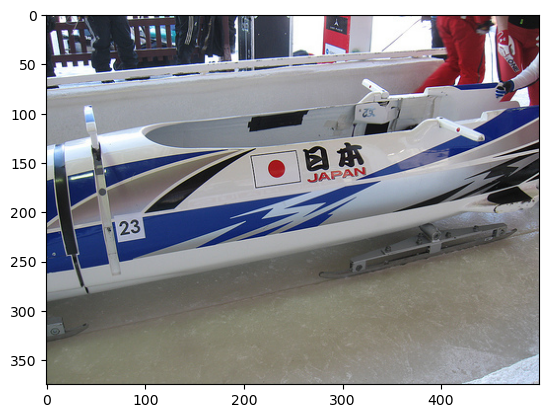

1/1 [==============================] - 0s 37ms/step
Logits: [('n02860847', 'bobsled', 18.012697), ('n04273569', 'speedboat', 14.149889), ('n04483307', 'trimaran', 12.414606)]
Class idx: 450


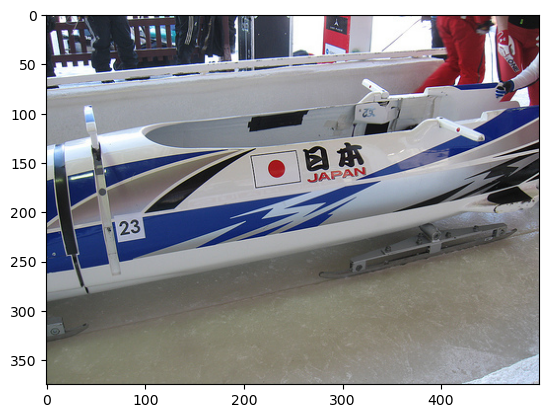

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 37ms/step
Logits before adv.: [('n02860847', 'bobsled', 18.02594), ('n04273569', 'speedboat', 14.152103), ('n04483307', 'trimaran', 12.411823)]
True label (max logit): bobsled (Index: 450)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: 0.13298487663269043
Label: Cardigan (Index: 264), Logit: 2.1420180797576904
Label: barrow (Index: 428), Logit: 1.3219307661056519
Label: Sealyham_terrier (Index: 190), Logit: -0.7905416488647461
Iteration 0, Loss: 17.396013259887695
Iteration 20, Loss: 10.366421699523926
Iteration 40, Loss: 8.330158233642578
Iteration 60, Loss: 7.024045944213867
Iteration 80, Loss: 6.038957595825195


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


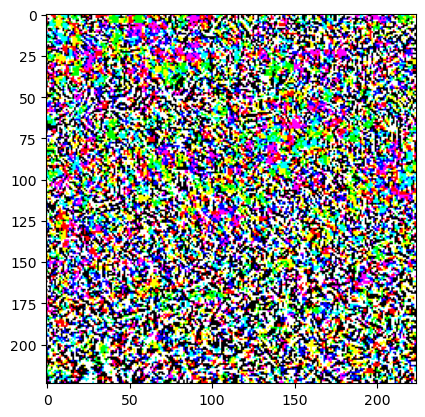

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


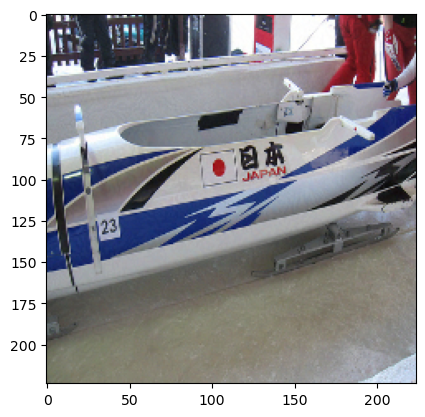

1/1 [==============================] - 0s 37ms/step
Logits after adv.: [('n02860847', 'bobsled', 8.786949), ('n03954731', 'plane', 6.8738627), ('n04228054', 'ski', 6.4506803)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 6.8738627433776855
Label: Cardigan (Index: 264), Logit: 5.421507835388184
Label: barrow (Index: 428), Logit: 3.567593574523926
Label: Sealyham_terrier (Index: 190), Logit: 4.376121997833252
Label: plane (726) | Logit Before: 0.13298 | Logit After: 6.87386 | Logit Diff: 6.74088
Label: Cardigan (264) | Logit Before: 2.14202 | Logit After: 5.42151 | Logit Diff: 3.27949
Label: barrow (428) | Logit Before: 1.32193 | Logit After: 3.56759 | Logit Diff: 2.24566
Label: Sealyham_terrier (190) | Logit Before: -0.79054 | Logit After: 4.37612 | Logit Diff: 5.16666
Average Difference: 4.3581735491752625
Watermark verified!
Image: #20


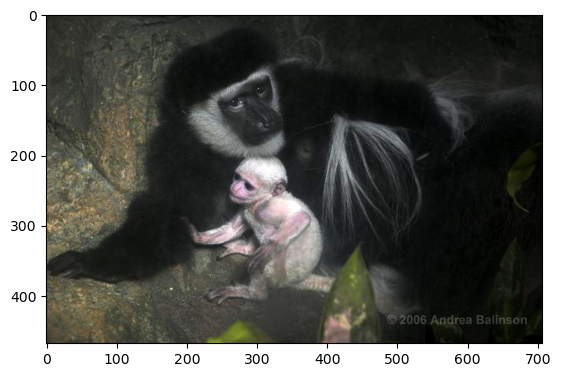

1/1 [==============================] - 0s 37ms/step
Logits: [('n02488702', 'colobus', 17.375067), ('n02483362', 'gibbon', 13.585051), ('n02483708', 'siamang', 11.762011)]
Class idx: 375


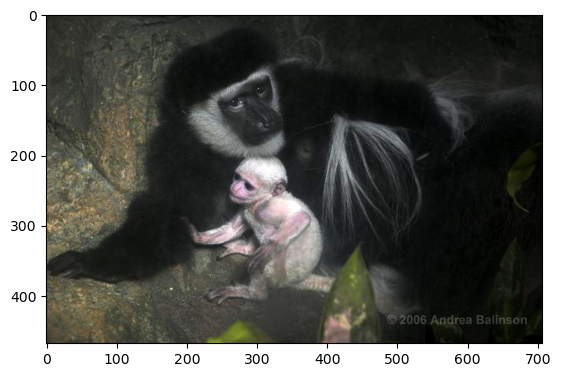

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 37ms/step
Logits before adv.: [('n02488702', 'colobus', 17.49253), ('n02483362', 'gibbon', 13.499472), ('n02483708', 'siamang', 11.65895)]
True label (max logit): colobus (Index: 375)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -4.870879650115967
Label: Cardigan (Index: 264), Logit: -0.7580114603042603
Label: barrow (Index: 428), Logit: 2.095268964767456
Label: Sealyham_terrier (Index: 190), Logit: -0.4082475006580353
Iteration 0, Loss: 18.532194137573242
Iteration 20, Loss: 9.320615768432617
Iteration 40, Loss: 7.564051151275635
Iteration 60, Loss: 6.72540283203125
Iteration 80, Loss: 6.268239498138428


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


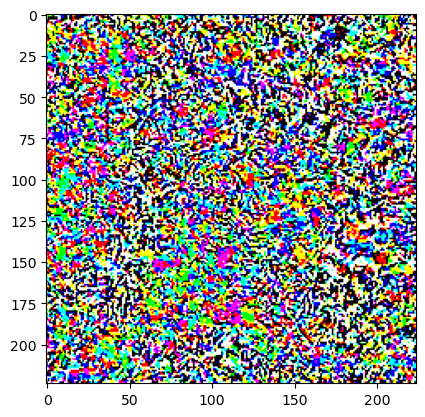

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Watermarked image saved as ./output/whitebox_watermarked_image.jpg


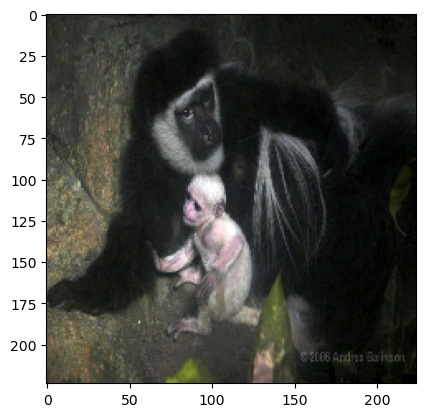

1/1 [==============================] - 0s 40ms/step
Logits after adv.: [('n02488702', 'colobus', 8.352771), ('n02113186', 'Cardigan', 6.647481), ('n02484975', 'guenon', 5.7538557)]

Predictions for secret labels:
Label: plane (Index: 726), Logit: 0.1558150053024292
Label: Cardigan (Index: 264), Logit: 6.6474809646606445
Label: barrow (Index: 428), Logit: 4.3475542068481445
Label: Sealyham_terrier (Index: 190), Logit: 5.520091533660889
Label: plane (726) | Logit Before: -4.87088 | Logit After: 0.15582 | Logit Diff: 5.02669
Label: Cardigan (264) | Logit Before: -0.75801 | Logit After: 6.64748 | Logit Diff: 7.40549
Label: barrow (428) | Logit Before: 2.09527 | Logit After: 4.34755 | Logit Diff: 2.25229
Label: Sealyham_terrier (190) | Logit Before: -0.40825 | Logit After: 5.52009 | Logit Diff: 5.92834
Average Difference: 5.153202831745148
Watermark verified!
Image: #21


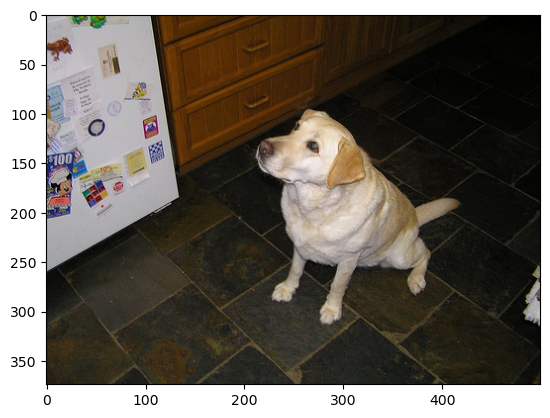

1/1 [==============================] - 0s 38ms/step
Logits: [('n02099712', 'Labrador_retriever', 12.345762), ('n02088364', 'beagle', 10.304478), ('n03207941', 'dishwasher', 9.779174)]
Class idx: 208


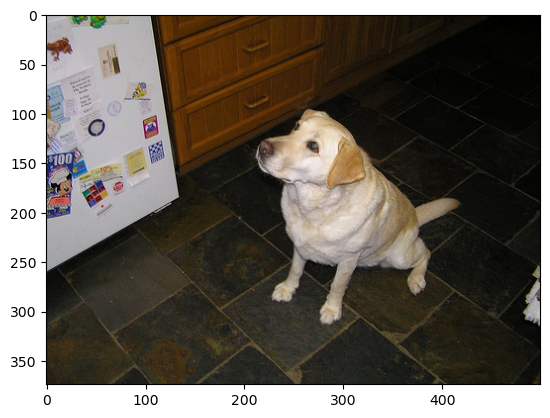

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 38ms/step
Logits before adv.: [('n02099712', 'Labrador_retriever', 12.290428), ('n02088364', 'beagle', 10.263105), ('n03207941', 'dishwasher', 9.804243)]
True label (max logit): Labrador_retriever (Index: 208)

Predictions for secret labels BEFORE perturbation:
Label: plane (Index: 726), Logit: -0.4636799693107605
Label: Cardigan (Index: 264), Logit: 3.8204638957977295
Label: barrow (Index: 428), Logit: 2.938734769821167
Label: Sealyham_terrier (Index: 190), Logit: 1.126341462135315
Iteration 0, Loss: 11.231109619140625
Iteration 20, Loss: 7.064112663269043


In [ ]:
root_folder = "../imagenet1k-val/imagenet-val" 
all_secret_logits_before, all_secret_logits_after, all_logits_before, all_logits_after = display_one_image_per_folder(root_folder,
                                                                                                                      secret_labels,
                                                                                                                      resnet50, 
                                                                                                                      optimizer, 
                                                                                                                      EPS, 
                                                                                                                      iterations = 100,
                                                                                                                      max_folders=30)

In [ ]:
plot_logit_histograms(all_secret_logits_before, all_secret_logits_after, secret_labels,bins =10)

In [ ]:

plot_roc_curve(all_secret_logits_before, all_secret_logits_after, secret_labels)

In [ ]:
flattened_before = np.array(all_logits_before).flatten().tolist()
flattened_after = np.array(all_logits_after).flatten().tolist()

plot_combined_histogram(flattened_before,flattened_after)